In [1]:
import numpy as np
import dask.array as da
from ipywidgets import FloatProgress
from IPython.display import display
from utils import *
%matplotlib inline
import matplotlib.pyplot as plt
from glob import glob

Using TensorFlow backend.


In [20]:
x_jop,y_jop = load_data_age('data/Jopp_Study/MHD/*.mhd',crop=(90,90,320),smart_crop=True)
x_jop,y_jop = load_data_age('data/Jopp_Study/MHD/*.mhd',crop=(90,90,320),smart_crop=False)

100%|██████████| 80/80 [00:02<00:00, 32.16it/s]


In [21]:
print(x_jop.shape, y_jop.shape)

((80, 24, 320, 320, 1), (80,))


In [22]:
x_jop = to_2d(x_jop)

In [23]:
x_jop = x_jop[::3]

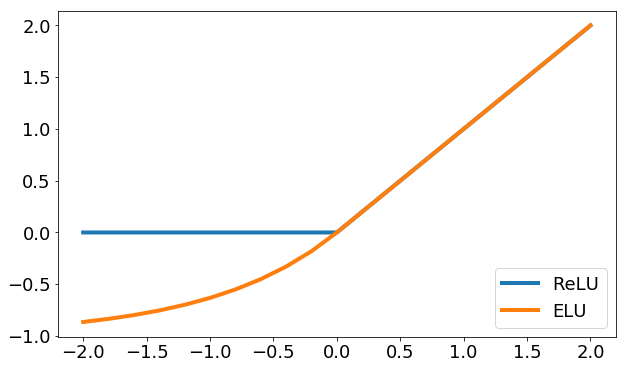

In [15]:
def relu(x):
    return np.where(x < 0, 0, x)

def elu(x):
    return np.where(x < 0, np.exp(x) - 1, x)

def selu(x):
    alpha = 1.6732632423543772848170429916717
    scale = 1.0507009873554804934193349852946
    return scale*np.where(x>=0.0, x, alpha*np.exp(x)-alpha)

x = np.linspace(-2, 2, num=21)
y1 = np.linspace(-1, 1, num=21)
y2 = np.linspace(-1, 1, num=21)

for i in range(len(x)):
    y1[i] = relu(x[i])
    y2[i] = elu(x[i])

plt.figure(figsize=(10,6))
plt.tick_params(axis='both', which='major', labelsize=18)
plt.plot(x, y1, linewidth=4.0)
plt.plot(x, y2, linewidth=4.0)
plt.legend(['ReLU', 'ELU'], loc='lower right', fontsize=18)
plt.show()

/usr/local/lib/python2.7/dist-packages/skimage/util/dtype.py:122: UserWarning: Possible precision loss when converting from float32 to uint16
  .format(dtypeobj_in, dtypeobj_out))


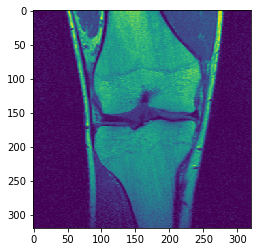

In [32]:
img = x_jop[100]
img /= img.max()
plt.imshow(img[..., 0])
io.imsave('orig.png', img[..., 0])

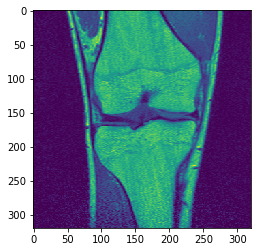

In [33]:
cor = n4_bias_correction(x_jop[100])
cor /= cor.max()
plt.imshow(cor[..., 0])
io.imsave('corr.png', cor[..., 0])

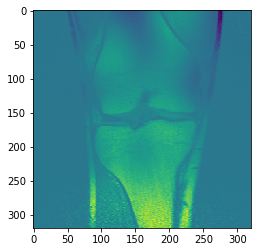

In [35]:
dif = cor - img
dif -= dif.min()
dif /= dif.max()
plt.imshow(dif[..., 0])
io.imsave('diff.png', dif[..., 0])

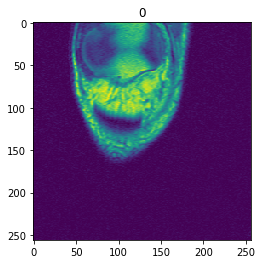

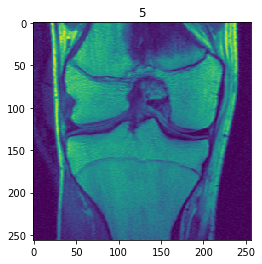

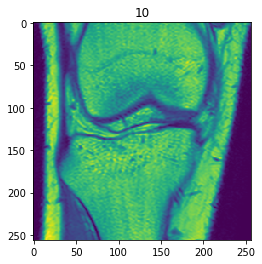

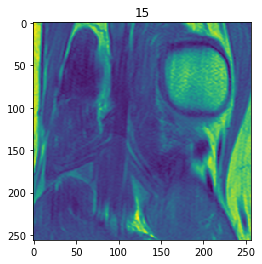

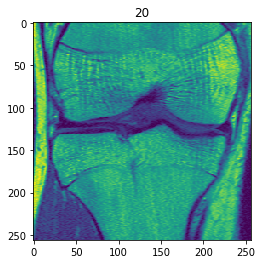

...

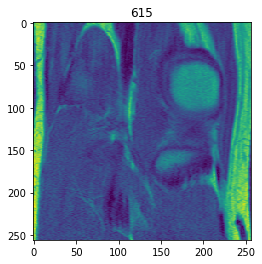

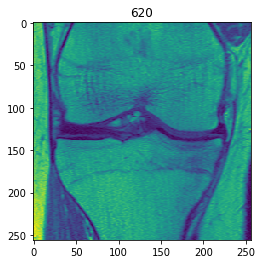

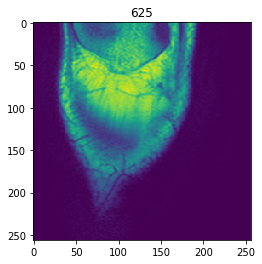

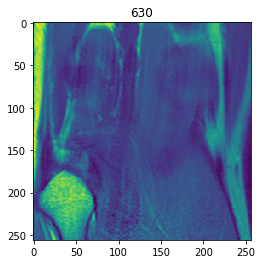

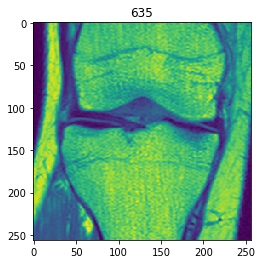

In [15]:
for i in range(0, len(x_jop), 5):
    plt.title(i)
    plt.imshow(x_jop[i, ..., 0])
    plt.show()

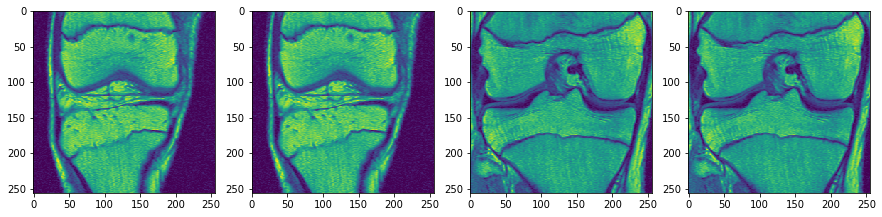

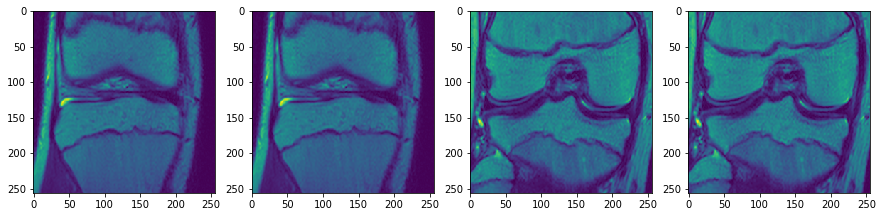

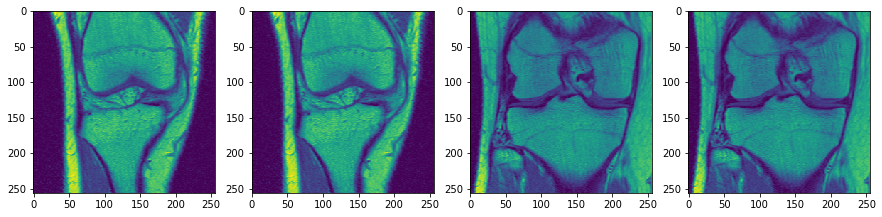

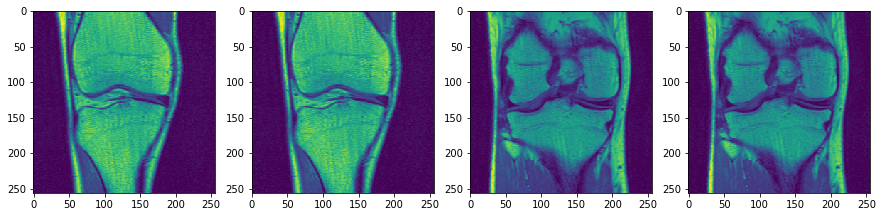

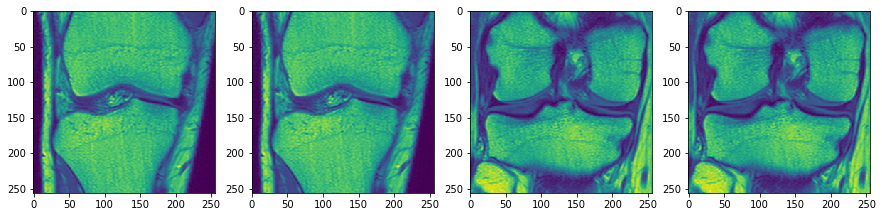

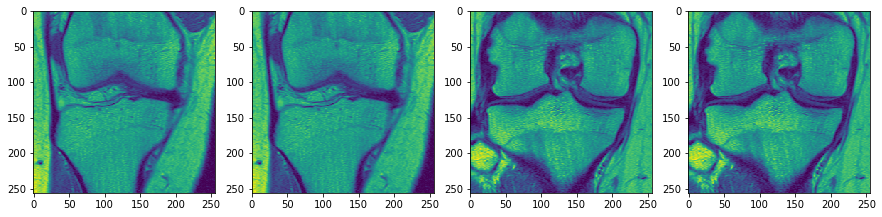

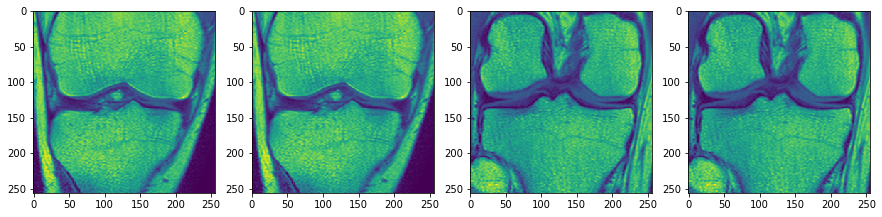

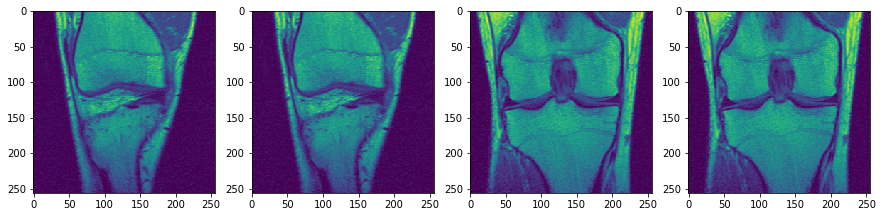

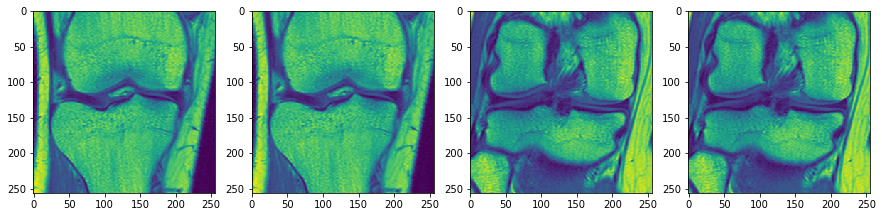

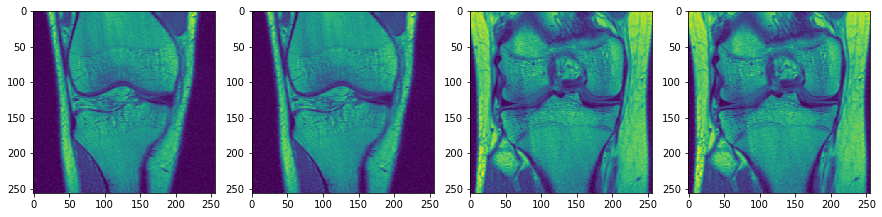

In [84]:
show_samples(x_jop, x_jop, 20)

In [2]:
l_age, l_seg = [], []
imgs = []

files = glob('data/*p*_Study/MHD/*.mhd')
for f in files:
    img = read_mhd(f)
    lbl = f.split('_')[3]
    l_age.append(int(lbl))

files = glob('data/*p*_Study/VOI_ORIG/*.mhd')
for f in files:
    lbl = f.split('_')[4]
    l_seg.append(int(lbl))

d_age = np.zeros(7, dtype='uint8')
d_seg = np.zeros(7, dtype='uint8')

for x in l_age:
    d_age[x-14] += 1
    
for x in l_seg:
    d_seg[x-14] += 1

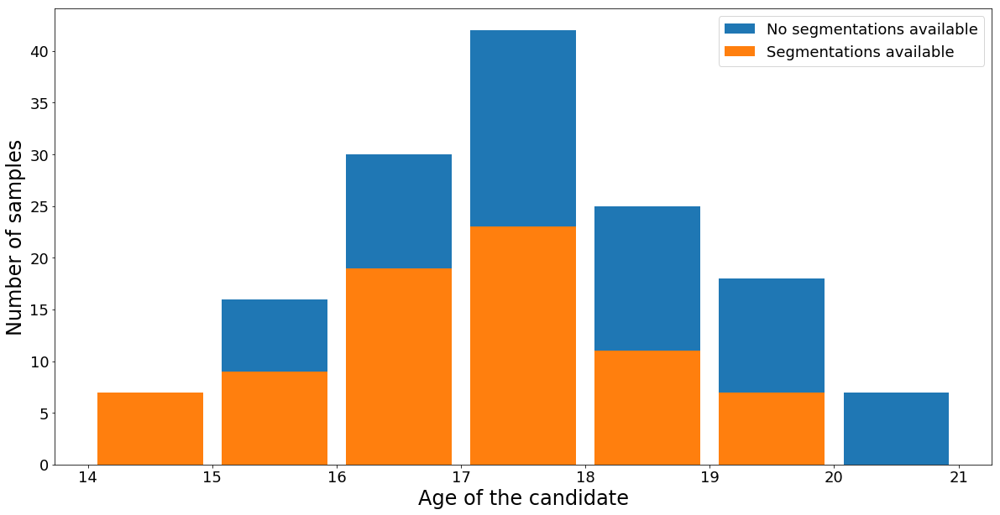

In [8]:
plt.figure(figsize=(20,10))
plt.ylabel('Number of samples', fontsize=24)
plt.xlabel('Age of the candidate', fontsize=24)
plt.tick_params(axis='both', which='major', labelsize=18)
plt.bar([14.5,15.5,16.5,17.5,18.5,19.5,20.5], d_age, 0.85)
plt.bar([14.5,15.5,16.5,17.5,18.5,19.5,20.5], d_seg, 0.85)
plt.legend(['No segmentations available', 'Segmentations available'], loc='upper right', fontsize=18)
plt.show()

In [31]:
distr

array([  0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   7.,  16.,  30.,  42.,  25.,  18.,   7.])

In [ ]:
for i in range(len(imgs)):
    plt.figure(figsize=(8,8))
    plt.title(str(i) + ' - ' + lbls[i])
    plt.imshow(imgs[i][18, ..., 0], cmap='gray')
    plt.show()

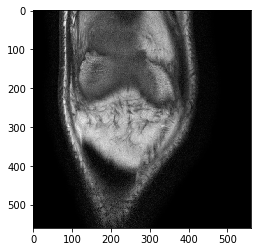

/usr/local/lib/python2.7/dist-packages/skimage/util/dtype.py:122: UserWarning: Possible precision loss when converting from float32 to uint16
  .format(dtypeobj_in, dtypeobj_out))


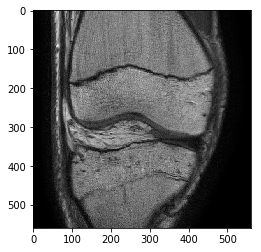

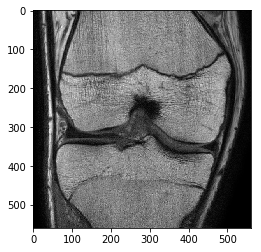

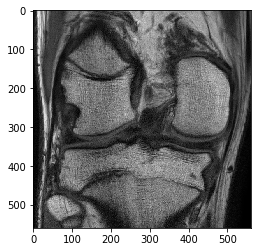

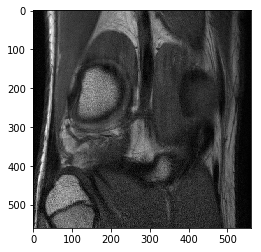

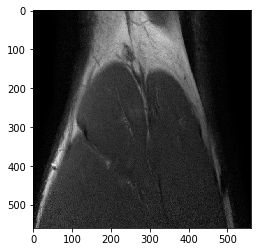

In [20]:
for i in range(6):
    img = imgs[18][i*7+3, ..., 0]
    img = img / img.max()
    plt.imshow(img, cmap='gray')
    plt.show()
    io.imsave(str(i*7+3) + '.png', img)

In [9]:
x_epi, _ = load_data('data/Epi_Study/VOI_LABEL/*.mhd', size=(224,224))
x_jop, _ = load_data('data/Jopp_Study/VOI_LABEL/*.mhd', size=(224,224))

100%|██████████| 40/40 [00:05<00:00,  7.65it/s]


In [10]:
h_jop = x_jop.mean(axis=(1,2,3,4))
h_epi = x_epi.mean(axis=(1,2,3,4))

In [11]:
plotme1 = np.zeros(13)
plotme2 = np.zeros(13)

In [12]:
for el in h_jop:
    plotme1[int(el) // 50] += 1

In [13]:
for el in h_epi:
    plotme2[int(el) // 50] += 1

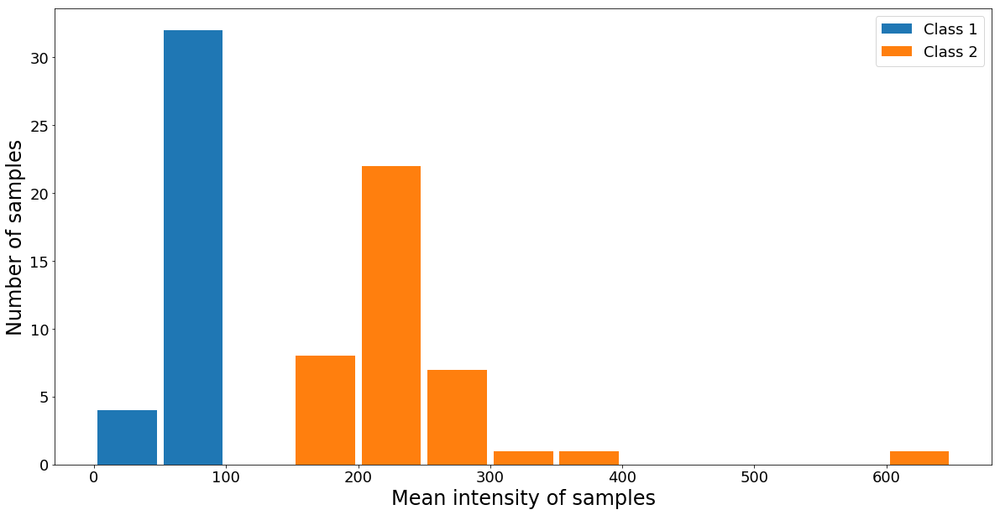

In [14]:
x = range(25,675,50)
width = 45
plt.figure(figsize=(20,10))
plt.ylabel('Number of samples', fontsize=24)
plt.xlabel('Mean intensity of samples', fontsize=24)
plt.tick_params(axis='both', which='major', labelsize=18)
plt.bar(x, plotme2, width)
plt.bar(x, plotme1, width)
plt.legend(['Class 1', 'Class 2'], loc='upper right', fontsize=18)

In [ ]:
img = x_va[18, ..., 0]
img = (img - img.min()) / (img.max() - img.min())

from skimage import segmentation
from skimage.filters import threshold_otsu, rank
from skimage.morphology import disk
#img = segmentation.felzenszwalb(img, sigma=0.5)
#img = rank.otsu(img, disk(2))
img = img > threshold_otsu(img)

plt.imshow(img)

In [80]:
x_te = np.load('data/2D/224/newnorm.npz')['x_te']
y_te = np.load('data/2D/224/newnorm.npz')['y_te']

In [81]:
model = UNet(x_te.shape[1:], 1, 32, 4, 1, 'elu', upconv=False)
model.compile(optimizer=Adam(lr=0.001, decay=0.001), loss=f1_loss, metrics=[f1])

model.load_weights('weights/seg2d_fibula.h5')
m_fib = model.predict(x_te, batch_size=1, verbose=1)

model.load_weights('weights/seg2d_tibia.h5')
m_tib = model.predict(x_te, batch_size=1, verbose=1)

model.load_weights('weights/seg2d_femur.h5')
m_fem = model.predict(x_te, batch_size=1, verbose=1)

for i in range(len(m_tib)):
    if m_tib[i].sum() < 500:
        m_tib[i] = 0
    if m_fem[i].sum() < 500:
        m_fem[i] = 0
        
p_te = np.concatenate((m_fib, m_tib, m_fem), axis=-1)

321/325 [============================>.] - ETA: 0s

In [82]:
diff = abs(y_te - p_te)
crop = x_te
for img in crop:
    img -= img.min()
    img /= img.max()
crop = p_te * x_te
crop = crop.sum(axis=-1)[..., np.newaxis]

In [83]:
def show_samples_single(x, num, axis_off=True, size=(20,20)):
    assert(len(x) >= 1)
    rnd = np.random.permutation(len(x[0]))
    for row in range(num):
        for col in range(len(x)):
            #plt.figure(figsize=size)
            img = x[col][rnd[row], ..., 0] if x[col][rnd[row]].shape[-1] == 1 else x[col][rnd[row]]
            plt.axis('off')
            plt.imshow(img.astype('float32'), cmap='gray')
            plt.show()

In [99]:
for i in range(len(x_te)):
    if f1_np(y_te[i], p_te[i]) < 0.1:
        print(i, f1_np(y_te[i], p_te[i]))

(9, 0.00037035530057461132)
(40, 0.008392382289302204)
(44, 0.00053561485734939169)
(45, 0.00029084482824853118)
(76, 0.002386265863137079)
(170, 0.00029457663275175784)
(200, 0.0019529810048637976)
(230, 0.00069604127375213229)
(231, 0.00037333607502013425)
(303, 0.00031245163235763142)
(304, 0.00012508140521385469)


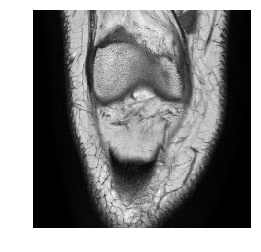

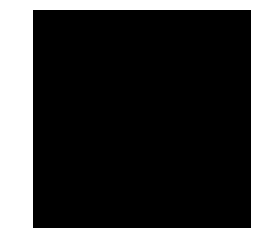

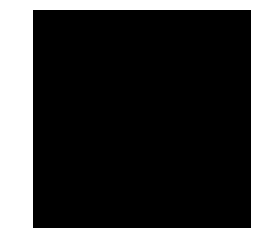

In [136]:
i = 93

plt.axis('off')
plt.imshow(x_te[i, ..., 0].astype('float32'), cmap='gray')
plt.show()

plt.axis('off')
plt.imshow(y_te[i].astype('float32'), cmap='gray')
plt.show()

plt.axis('off')
plt.imshow(p_te[i].astype('float32'), cmap='gray')
plt.show()

In [43]:
x_epi, _ = load_data_age('data/Epi_Study/MHD/*000*.mhd', crop=[96,96], size=(224,224))

100%|██████████| 16/16 [00:02<00:00,  7.22it/s]


In [44]:
img = x_epi[0]

In [45]:
#for slc in tqdm(range(len(img))):
#    img[slc] = n4_bias_correction(img[slc])

In [46]:
img -= img.mean()
img /= img.std()

In [102]:
model = UNet(img.shape[1:], 1, 32, 4, 1, 'elu', upconv=False)
model.compile(optimizer=Adam(lr=0.001, decay=0.001), loss=f1_loss, metrics=[f1])

model.load_weights('weights/seg2d_transfer.h5')
pred = model.predict(img, batch_size=1)

In [130]:
slc = 20

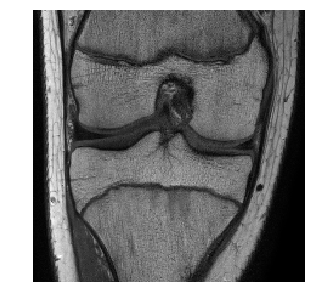

In [131]:
plt.figure(figsize=(5,5))
plt.axis('off')
plt.imshow(img[slc, ..., 0], cmap='gray')

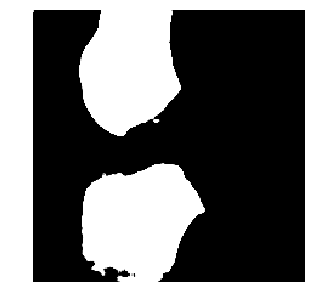

In [105]:
plt.figure(figsize=(5,5))
plt.axis('off')
plt.imshow(pred[slc, ..., 0], cmap='gray')

In [49]:
model = UNet(img.shape[1:], 1, 32, 4, 1, 'elu', upconv=False)
model.compile(optimizer=Adam(lr=0.001, decay=0.001), loss=f1_loss, metrics=[f1])
model.load_weights('weights/seg2d_all.h5')
pred = model.predict(img, batch_size=1)

In [50]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(input=model.input, output=layer_outputs)
activations = activation_model.predict(img)

In [41]:
for el in activations:
    print(el.shape)

(41, 224, 224, 1)
(41, 224, 224, 8)
(41, 224, 224, 8)
(41, 112, 112, 8)
(41, 112, 112, 8)
(41, 112, 112, 8)
(41, 56, 56, 8)
(41, 56, 56, 8)
(41, 56, 56, 8)
(41, 28, 28, 8)
(41, 28, 28, 8)
(41, 28, 28, 8)
(41, 28, 28, 8)
(41, 56, 56, 8)
(41, 56, 56, 8)
(41, 56, 56, 8)
(41, 56, 56, 8)
(41, 112, 112, 8)
(41, 112, 112, 8)
(41, 112, 112, 8)
(41, 112, 112, 8)
(41, 224, 224, 8)
(41, 224, 224, 8)
(41, 224, 224, 8)
(41, 224, 224, 8)
(41, 224, 224, 1)


Layer: 25


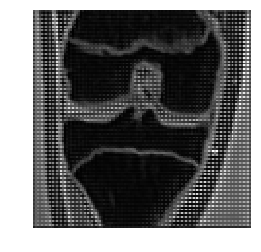

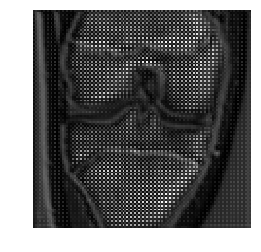

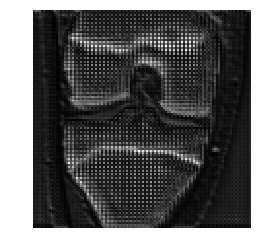

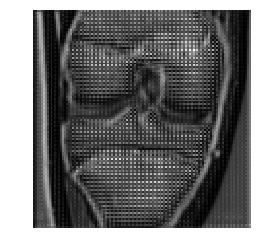

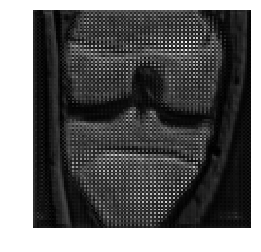

...

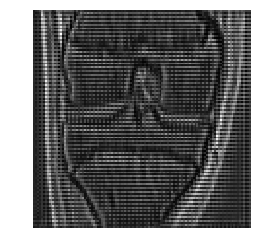

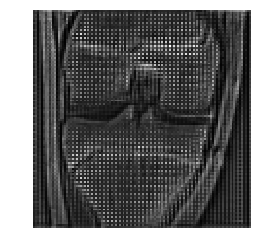

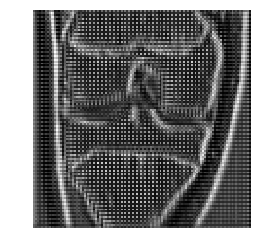

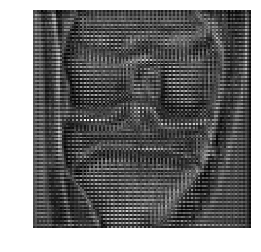

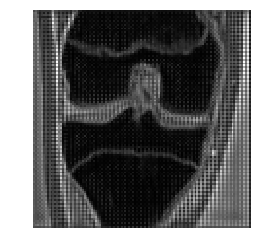

Layer: 26


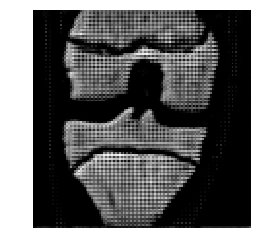

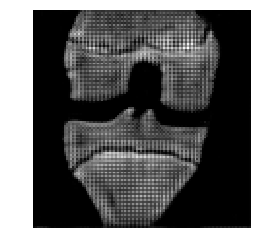

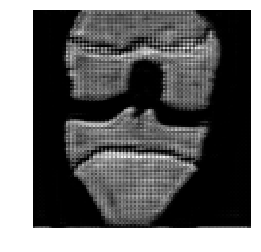

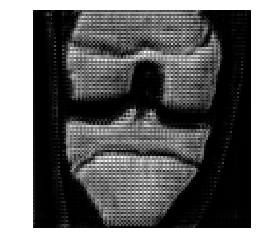

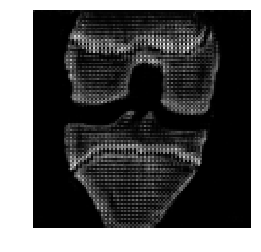

...

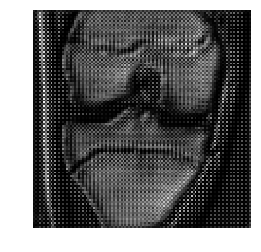

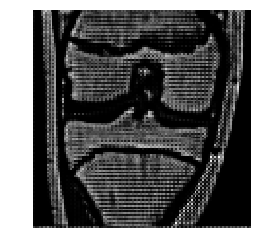

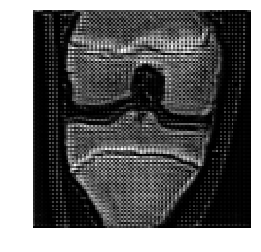

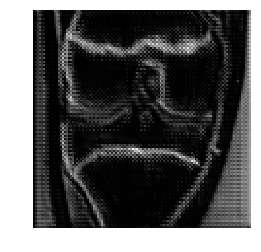

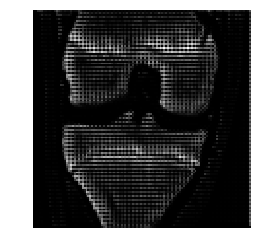

Layer: 27


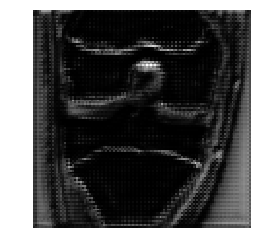

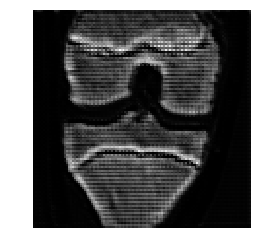

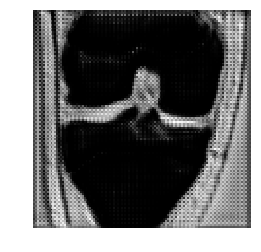

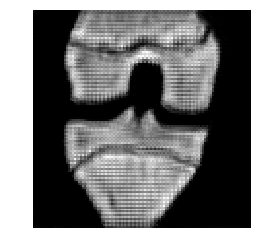

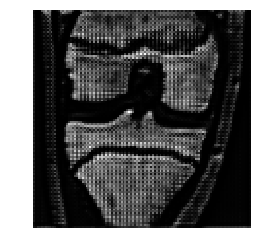

...

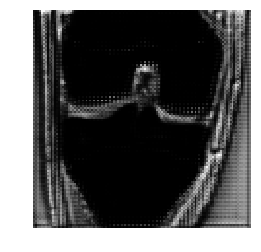

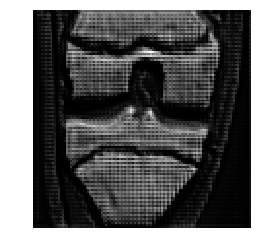

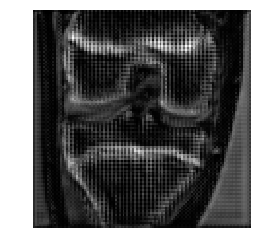

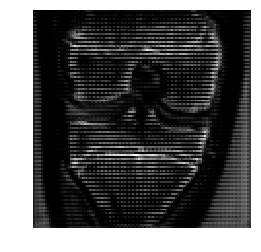

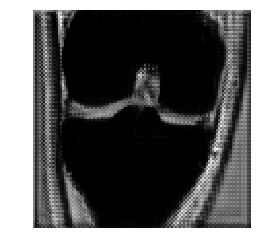

Layer: 28


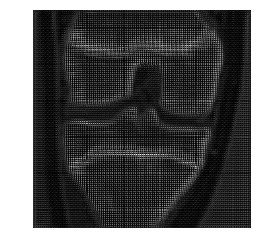

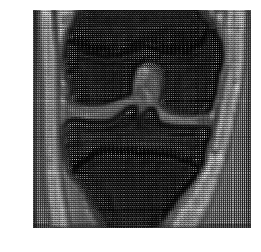

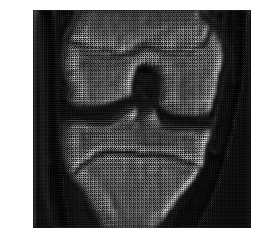

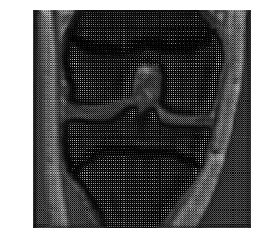

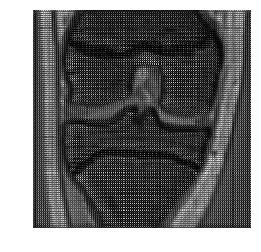

...

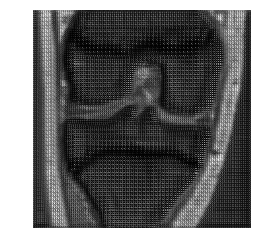

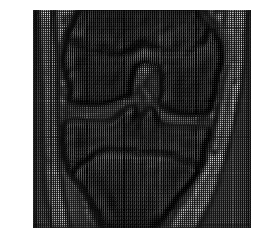

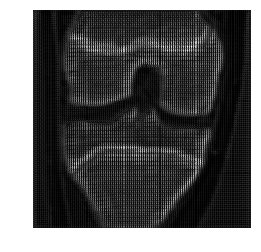

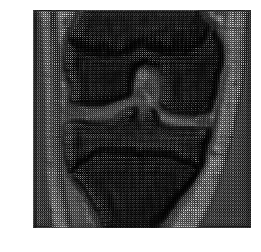

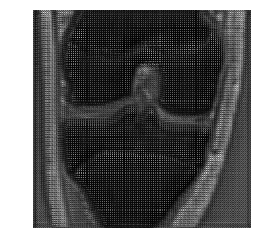

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


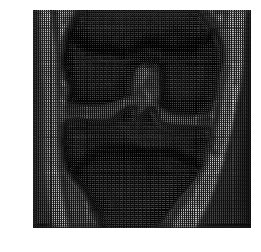

Layer: 29


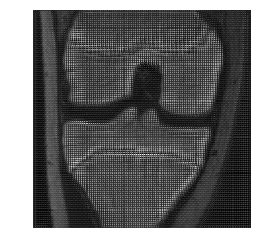

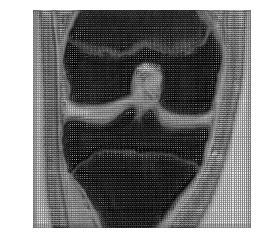

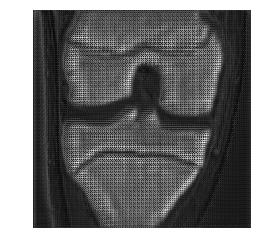

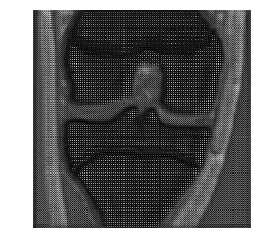

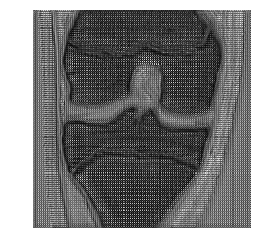

...

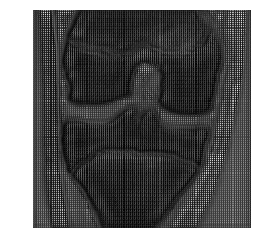

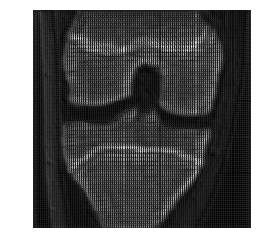

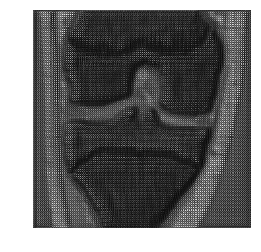

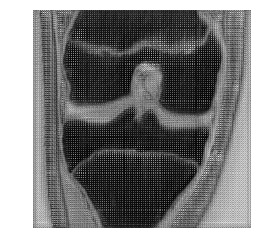

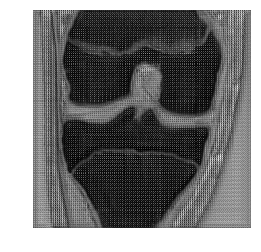

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


Layer: 30


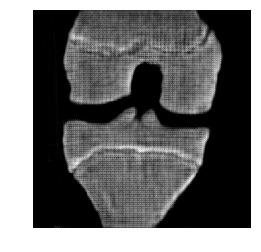

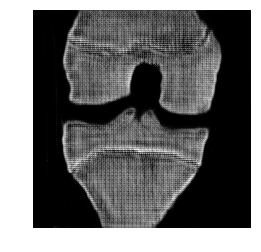

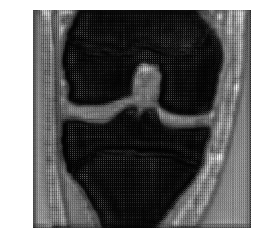

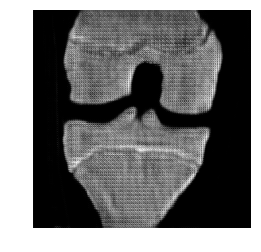

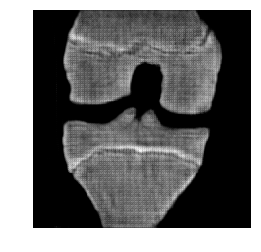

...

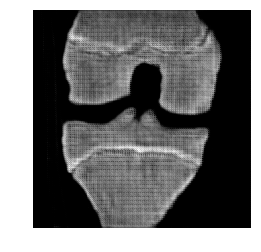

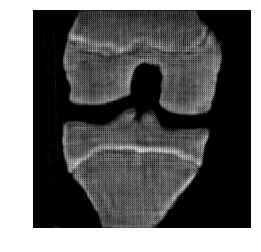

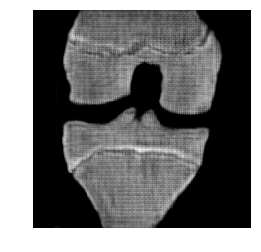

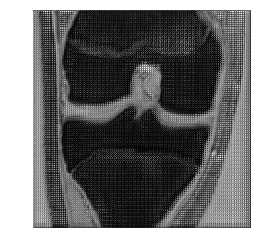

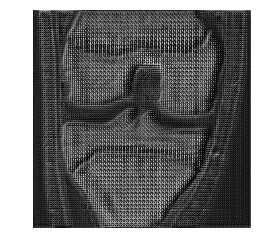

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


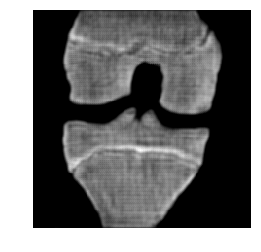

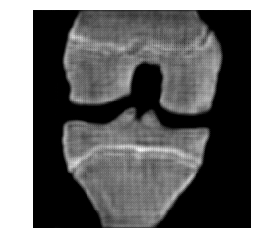

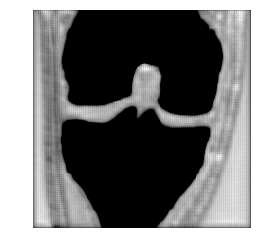

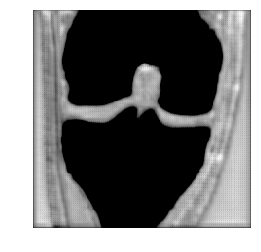

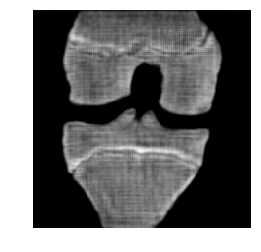

...

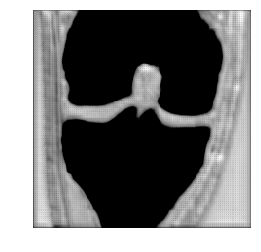

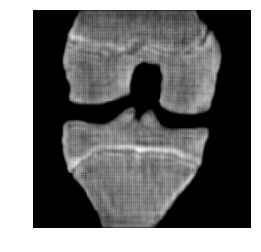

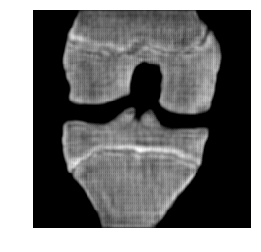

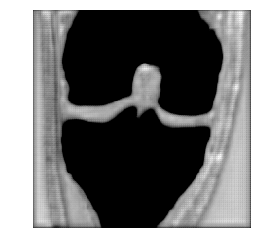

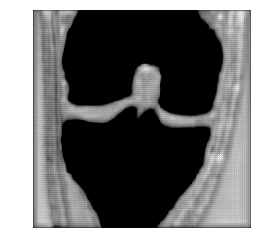

Layer: 32


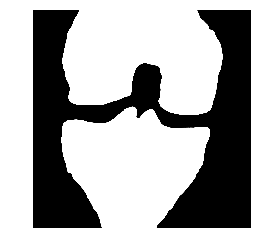

In [53]:
for layer in range(25, 33):
    print('Layer: '+ str(layer))
    for ch in range(activations[layer].shape[-1]):
        plt.imshow(activations[layer][20, ..., ch], cmap='gray')
        plt.axis('off')
        plt.show()

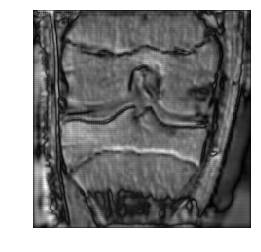

In [17]:
l = 24
img = np.zeros((224,224))
for i in range(activations[l].shape[-1]):
    img += activations[l][20, ..., i]

plt.axis('off')
plt.imshow(img, cmap='gray')

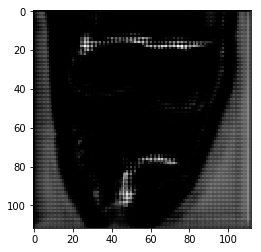

In [56]:
plt.imshow(activations[27][12, ..., 7], cmap='gray')

In [152]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_12 (InputLayer)            (None, 224, 224, 1)   0                                            
____________________________________________________________________________________________________
conv2d_210 (Conv2D)              (None, 224, 224, 32)  320         input_12[0][0]                   
____________________________________________________________________________________________________
conv2d_211 (Conv2D)              (None, 224, 224, 32)  9248        conv2d_210[0][0]                 
____________________________________________________________________________________________________
max_pooling2d_45 (MaxPooling2D)  (None, 112, 112, 32)  0           conv2d_211[0][0]                 
___________________________________________________________________________________________